# Stable Diffusion text to image models with Azure AI Foundry

Microsoft is excited to collaborate with Stability AI, one of the leaders in AI-powered visual generation to bring Stable Diffusion 3.5 Large, Stable Image Ultra, and Stable Image Core to the model catalog in Azure AI Foundry.

**Stable Image Large**

At 8.1 billion parameters, Stable Diffusion 3.5 is the most powerful model in the Stable Diffusion family. Our collaboration with Stability AI brings this sophisticated model to our catalog, introducing image-to-image capabilities to Azure AI Foundry for the first time. The model delivers exceptional text-to-image generation with superior quality and prompt adherence, making it ideal for professional use cases at 1 megapixel resolution.  

**Stable Image Ultra**

Powered by the advanced capabilities of Stable Diffusion 3.5 Large, Stable Image Ultra sets a new standard in photorealism. Stable Image Ultra is ideal for product imagery in marketing and advertising. It also excels in typography, dynamic lighting, and vibrant color rendering. 

**Stable Image Core**

Leveraging an enhanced version of SDXL, Stable Image Core, delivers exceptional speed and efficiency while maintaining the high-quality output synonymous with Stable Diffusion models. 

<img src="https://images.squarespace-cdn.com/content/v1/6213c340453c3f502425776e/0b6d9266-bd05-4a77-b701-414ff9cca0a0/azure-rectangle.png?format=2500w" width=600>

> https://techcommunity.microsoft.com/blog/machinelearningblog/introducing-stability-ai-generative-visual-models-to-azure-ai-foundry/4377271

In [1]:
import base64
import gradio as gr
import json
import os
import random
import urllib.request

from datetime import datetime
from dotenv import load_dotenv
from io import BytesIO
from PIL import Image

In [2]:
today = datetime.now().strftime("%Y-%m-%d %H:%M:%S")
print(f"Today is {today}")

Today is 2025-03-03 14:26:44


In [3]:
load_dotenv("azure.env")

True

In [4]:
IMAGES_DIR = "images"

os.makedirs(IMAGES_DIR, exist_ok=True)

## Functions

In [5]:
def get_env_variable(var_name):
    """Get environment variable or return exception."""
    try:
        return os.getenv(var_name)
    except KeyError:
        raise Exception(f"Environment variable {var_name} not found")

In [6]:
def sd(model, prompt, negative_prompt):
    """
    Generate an image using Stable Diffusion models.
    """
    print(f"Prompt: {prompt}")
    print(f"Negative Prompt: {negative_prompt}")
    print(f"Model: Stable Diffusion {model} in Azure AI Foundry")
    
    if model == "ultra":  # Stable Diffusion Ultra model
        url = get_env_variable("url_ultra")
        api_key = get_env_variable("api_key_ultra")
    elif model == "large":  # Stable Diffusion 3.5 Large
        url = get_env_variable("url_large")
        api_key = get_env_variable("api_key_large")
    else:
        print("Error")
        return None

    # Prepare the data payload
    seed = random.randint(1, 4_294_967_294)
    print(f"Seed: {seed}")
    
    data = {
        "prompt": prompt[:10000],
        "negative_prompt": negative_prompt[:10000],
        "size": "916x1145", # '672x1566', '768x1366', '836x1254', '916x1145', '1024x1024', '1145x916', '1254x836', '1366x768' or '1566x672
        "output_format": "png", # png, jpeg or webp
        "seed": seed,  # for repeatability 
    }
    body = str.encode(json.dumps(data))

    # Headers
    headers = {
        'Content-Type': 'application/json',
        'Accept': 'application/json',
        'Authorization': f'Bearer {api_key}'
    }

    # request
    req = urllib.request.Request(url, body, headers)

    try:
        # Send the request and get the response
        response = urllib.request.urlopen(req)
        result = response.read()
        
        img = Image.open(BytesIO(base64.b64decode(
            json.loads(result)["image"])))
        output_image_filename = os.path.join(IMAGES_DIR, f"sd_{model}_{seed}_{prompt[:70]}.jpg")
        
        img.save(output_image_filename)
        print(f"Output image file: {output_image_filename}\n")
        return img

    except urllib.error.HTTPError as error:
        print(f"The request failed with status code: {error.code}")
        print(error.info())
        print(error.read().decode("utf8", 'ignore'))
    except Exception as e:
        print(f"An error occurred: {str(e)}")

## Tests

Prompt: Na'vi, avatar, james cameron, insane details
Negative Prompt: 
Model: Stable Diffusion ultra in Azure AI Foundry
Seed: 2870714781
Output image file: images/sd_ultra_2870714781_Na'vi, avatar, james cameron, insane details.jpg



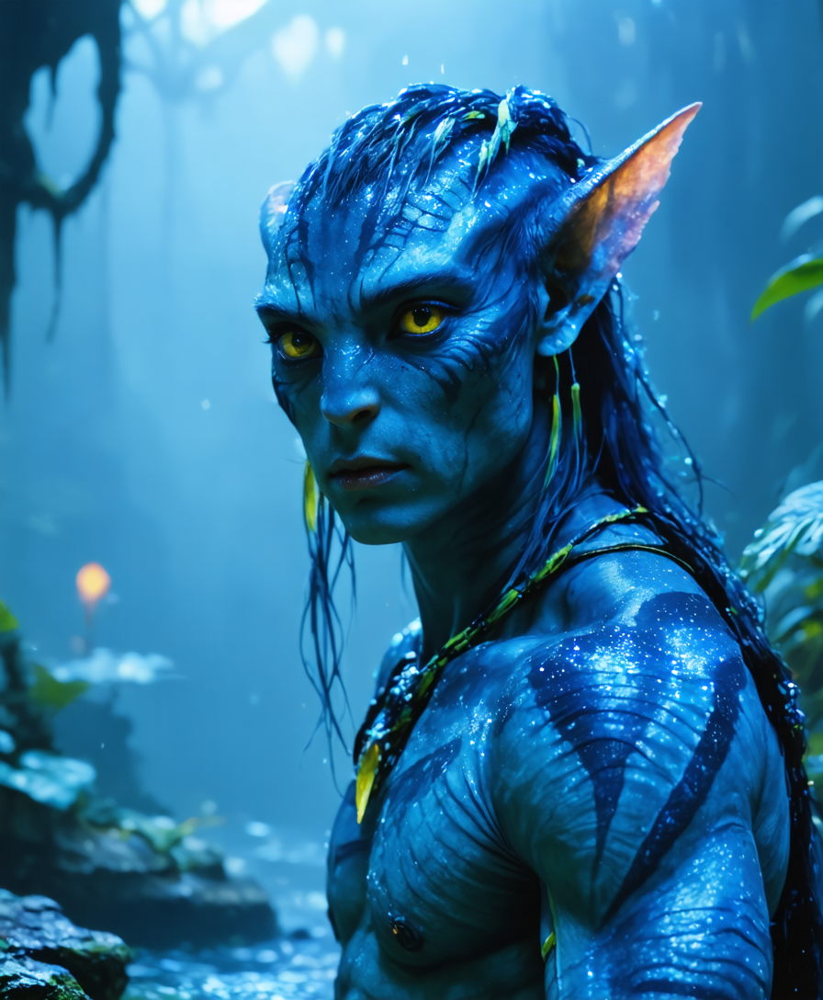

In [7]:
prompt = "Na'vi, avatar, james cameron, insane details"
negative_prompt = "blue background"

sd("ultra", prompt, "")

Prompt: A teenage girl of afghani descent with striking rainbow eyes stares at the camera with a deep read head scarf. kodachrome film
Negative Prompt: sky in the background
Model: Stable Diffusion ultra in Azure AI Foundry
Seed: 276003002
Output image file: images/sd_ultra_276003002_A teenage girl of afghani descent with striking rainbow eyes stares at.jpg



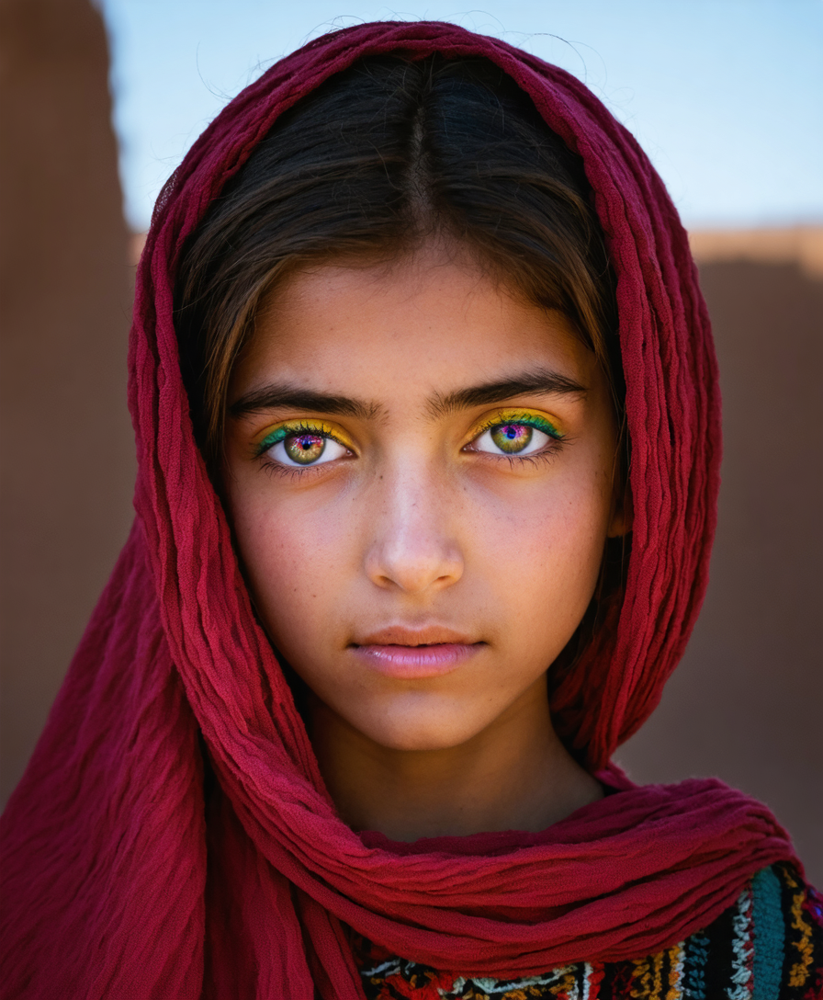

In [8]:
prompt = "A teenage girl of afghani descent with striking rainbow eyes stares at the camera with a deep read head scarf. kodachrome film"
negative_prompt = "sky in the background"

sd("ultra", prompt, negative_prompt)

Prompt: Magical realism photo portrait, hipster fashion, morning light, 50-something man with long hair, pensive, candid
Negative Prompt: 
Model: Stable Diffusion ultra in Azure AI Foundry
Seed: 3200992933
Output image file: images/sd_ultra_3200992933_Magical realism photo portrait, hipster fashion, morning light, 50-som.jpg



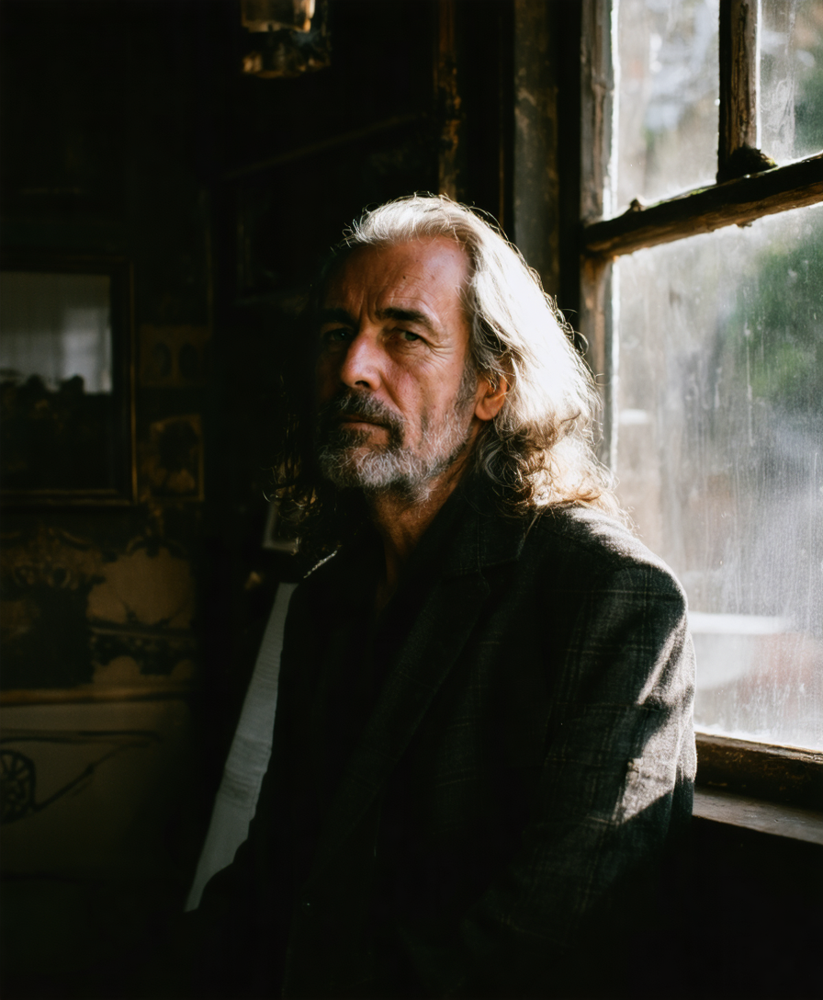

In [9]:
prompt = "Magical realism photo portrait, hipster fashion, morning light, 50-something man with long hair, pensive, candid"

sd("ultra", prompt, "")

Prompt: Photo of three potions: the first potion is blue,  the second potion is red, the third potion is green with the label 'poison'. Old apothecary.
Negative Prompt: 
Model: Stable Diffusion ultra in Azure AI Foundry
Seed: 502477227
Output image file: images/sd_ultra_502477227_Photo of three potions: the first potion is blue,  the second potion i.jpg



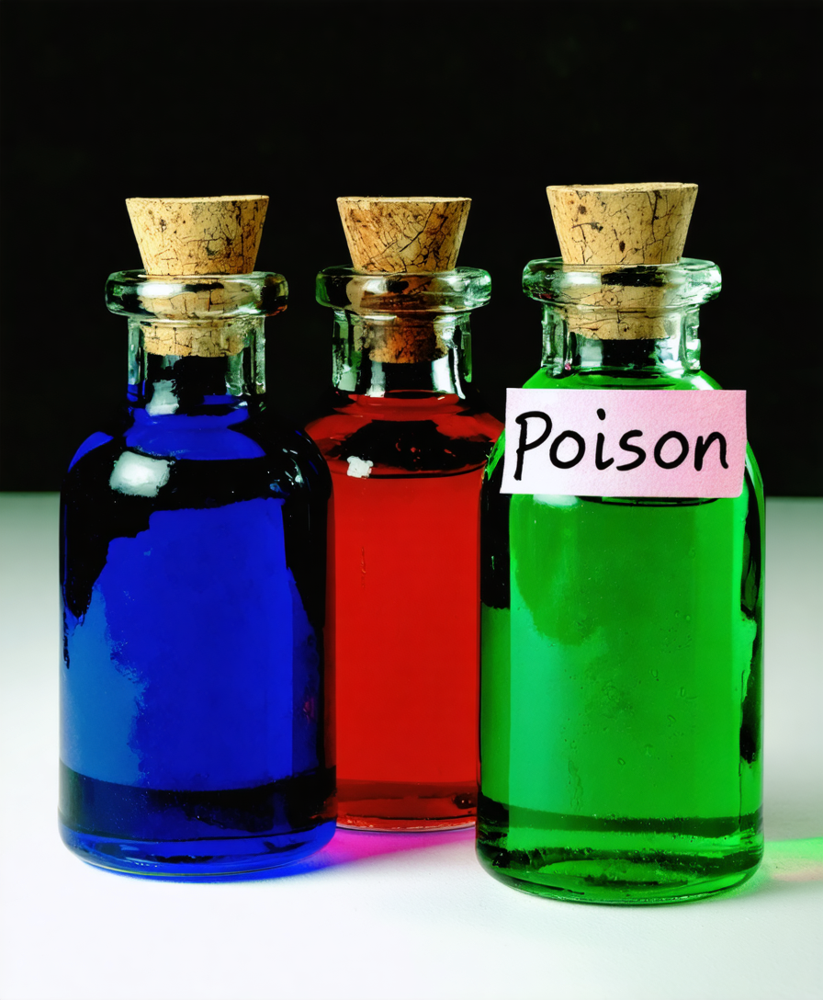

In [21]:
prompt = "Photo of three potions: the first potion is blue,  the second potion is red, the third potion is green with the label 'poison'. Old apothecary."

sd("ultra", prompt, "")

Prompt: 2D Vector Illustration of a child with soccer ball Art for Sublimation, Design Art, Chrome Art, Painting and Stunning Artwork, Highly Detailed Digital Painting, Airbrush Art, Highly Detailed Digital Artwork, Dramatic Artwork, stained antique yellow copper paint, digital airbrush art, detailed by Mark Brooks, Chicano airbrush art, Swagger! snake Culture
Negative Prompt: 
Model: Stable Diffusion ultra in Azure AI Foundry
Seed: 780835086
Output image file: images/sd_ultra_780835086_2D Vector Illustration of a child with soccer ball Art for Sublimation.jpg



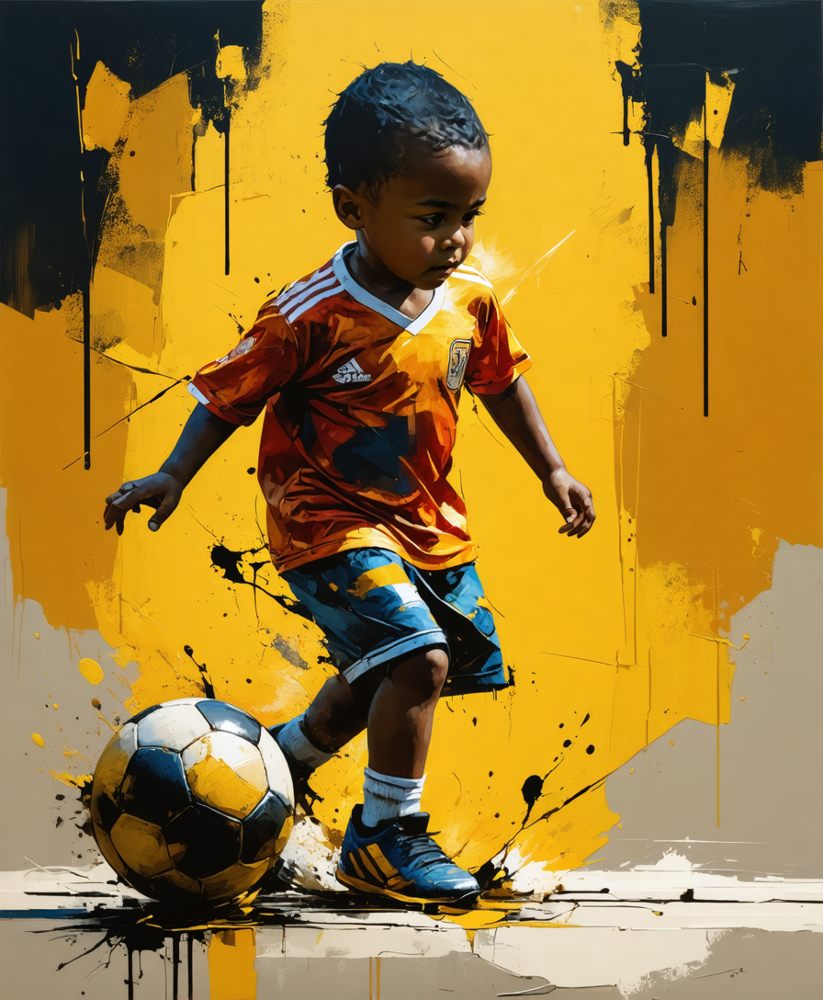

In [11]:
prompt = "2D Vector Illustration of a child with soccer ball Art for Sublimation, Design Art, Chrome Art, Painting and Stunning Artwork, Highly Detailed Digital Painting, Airbrush Art, Highly Detailed Digital Artwork, Dramatic Artwork, stained antique yellow copper paint, digital airbrush art, detailed by Mark Brooks, Chicano airbrush art, Swagger! snake Culture"

sd("ultra", prompt, "")

Prompt: Comicbook: a girl sitting in the cafe, comic, graphic illustration, comic art, graphic novel art, vibrant, highly detailed, colored, 2d minimalistic.
Negative Prompt: 
Model: Stable Diffusion ultra in Azure AI Foundry
Seed: 90874418
Output image file: images/sd_ultra_90874418_Comicbook: a girl sitting in the cafe, comic, graphic illustration, co.jpg



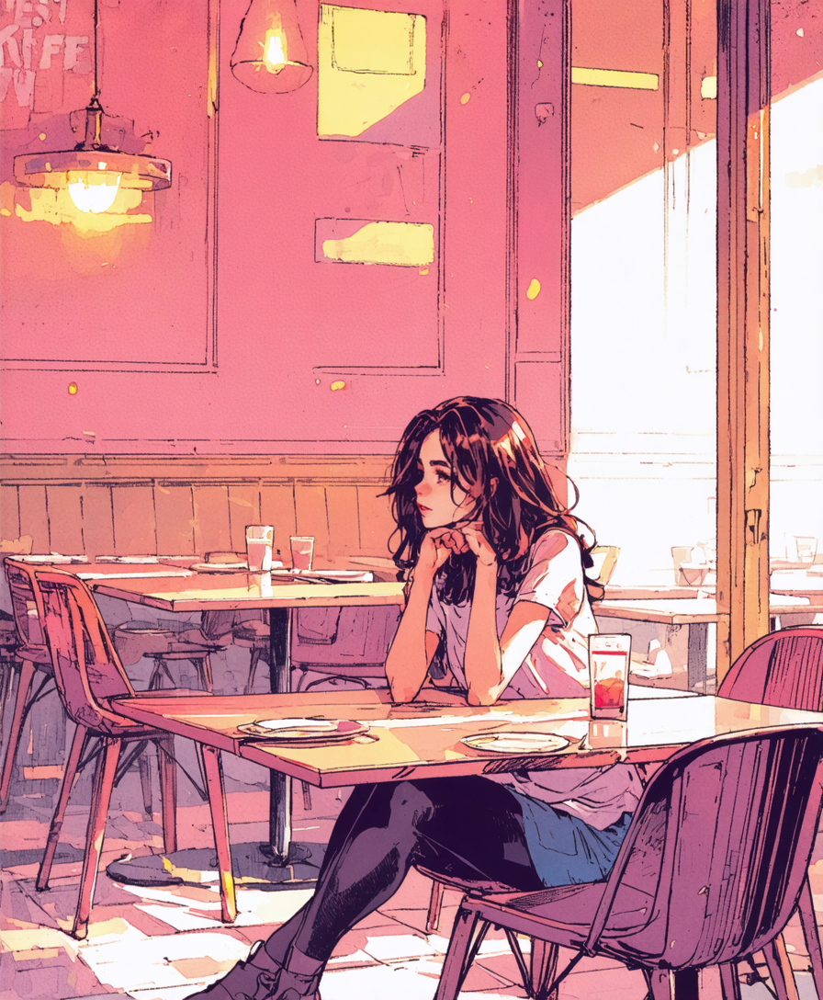

In [12]:
prompt = "Comicbook: a girl sitting in the cafe, comic, graphic illustration, comic art, graphic novel art, vibrant, highly detailed, colored, 2d minimalistic."

sd("ultra", prompt, "")

Prompt: An angry Ghost Pumpkin. Dense, quirky portrait in cinematic Pixar 3D Rendering and desturated Halloween colors. The image background is a complex and unsettling digestive system with intricate details and Liquid, sticky, melting slime.
Negative Prompt: 
Model: Stable Diffusion large in Azure AI Foundry
Seed: 2020659505
Output image file: images/sd_large_2020659505_An angry Ghost Pumpkin. Dense, quirky portrait in cinematic Pixar 3D R.jpg



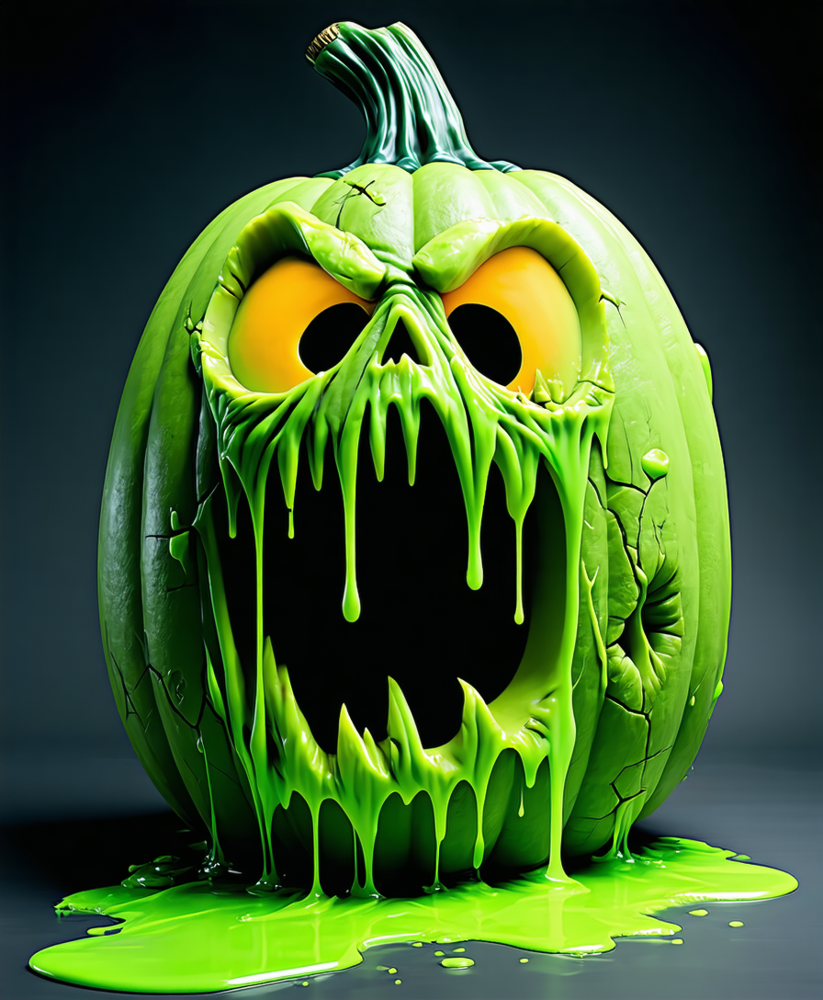

In [20]:
prompt = "An angry Ghost Pumpkin. Dense, quirky portrait in cinematic Pixar 3D Rendering and desturated Halloween colors. The image background is a complex and unsettling digestive system with intricate details and Liquid, sticky, melting slime."

sd("large", prompt, "")

Prompt: Cinematic photo portrait of man, cyberpunk, in heavy raining futuristic tokyo, rooftop, cyberpunk night, extremely beautiful, elegant, neon light, highly detailed. 35mm photograph, film, bokeh, professional, 4k, highly detailed.
Negative Prompt: 
Model: Stable Diffusion ultra in Azure AI Foundry
Seed: 2583449356
Output image file: images/sd_ultra_2583449356_Cinematic photo portrait of man, cyberpunk, in heavy raining futuristi.jpg



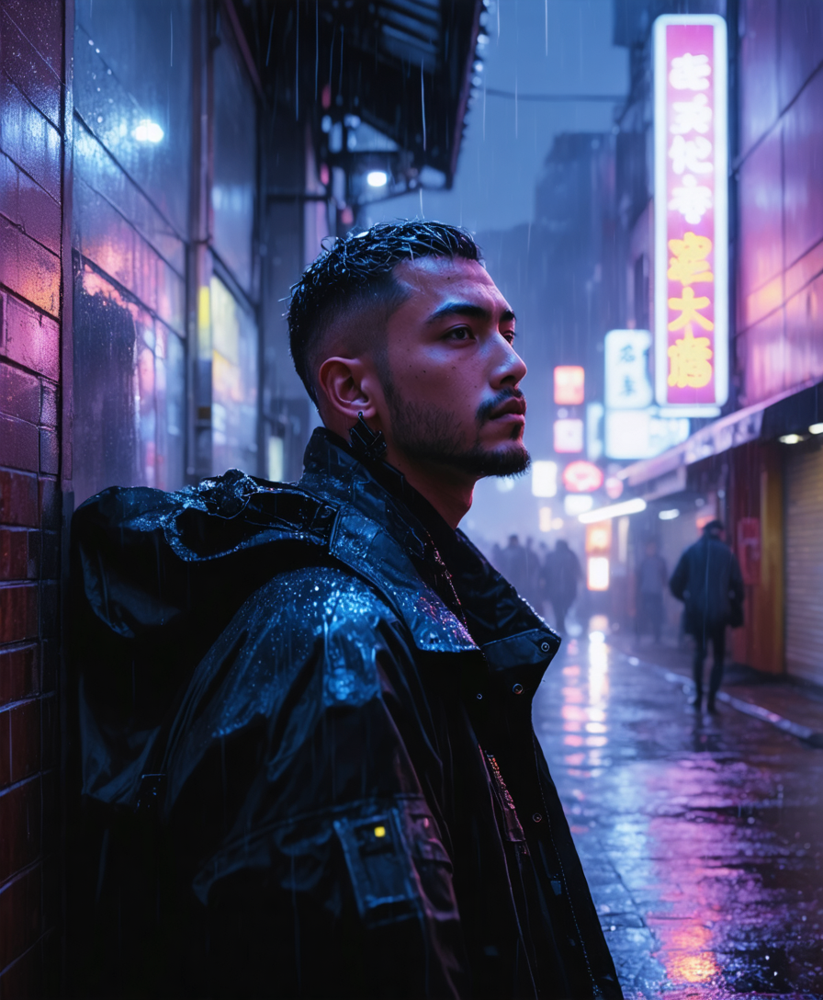

In [14]:
prompt = "Cinematic photo portrait of man, cyberpunk, in heavy raining futuristic tokyo, rooftop, cyberpunk night, extremely beautiful, elegant, neon light, highly detailed. 35mm photograph, film, bokeh, professional, 4k, highly detailed."

sd("ultra", prompt, "")

Prompt: Black and white street photography of a rainy night in New York, reflections on wet pavement.
Negative Prompt: 
Model: Stable Diffusion ultra in Azure AI Foundry
Seed: 1435405066
Output image file: images/sd_ultra_1435405066_Black and white street photography of a rainy night in New York, refle.jpg



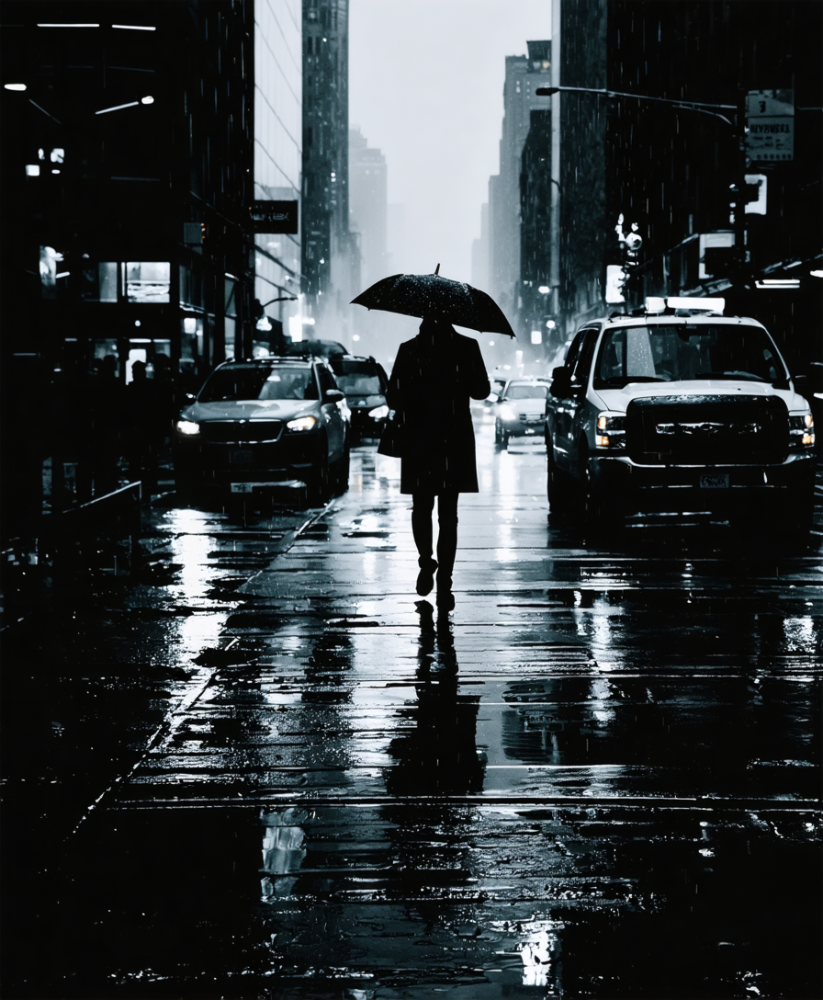

In [15]:
prompt = "Black and white street photography of a rainy night in New York, reflections on wet pavement."

sd("ultra", prompt, "")

Prompt: Underwater photography of a coral reef, with diverse marine life and a scuba diver for scale.
Negative Prompt: 
Model: Stable Diffusion ultra in Azure AI Foundry
Seed: 3369937796
Output image file: images/sd_ultra_3369937796_Underwater photography of a coral reef, with diverse marine life and a.jpg



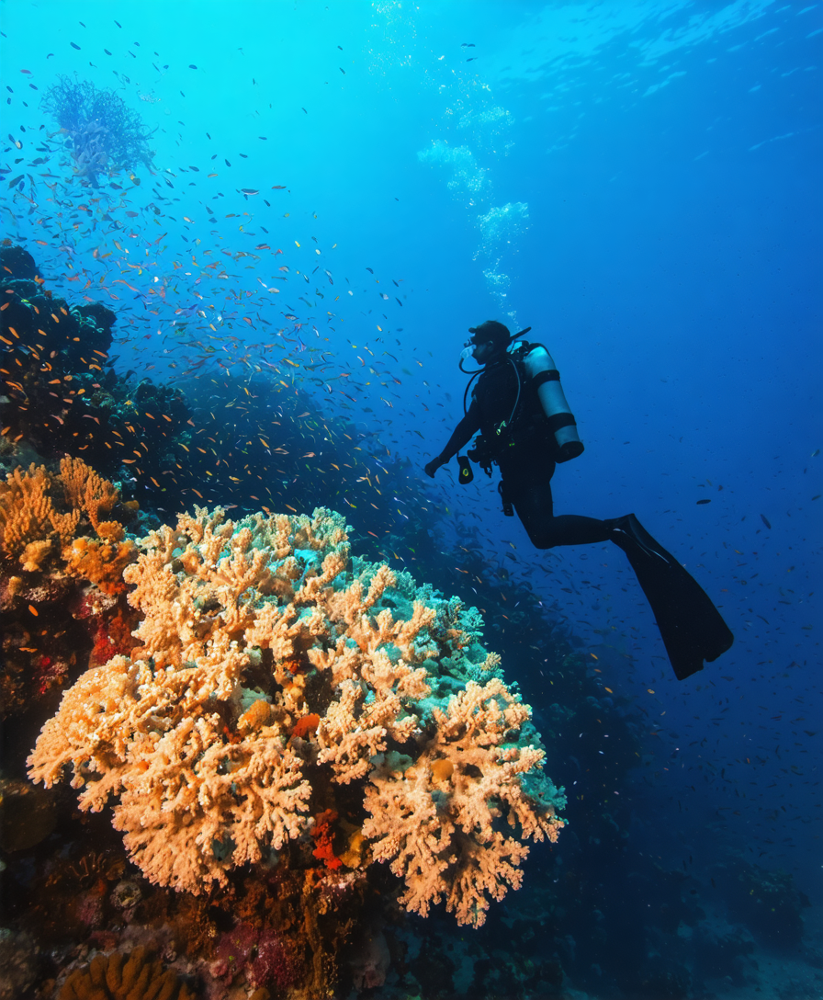

In [16]:
prompt = "Underwater photography of a coral reef, with diverse marine life and a scuba diver for scale."

sd("ultra", prompt, "")

## Animated gif file generation

In [17]:
gif_file = "animated.gif"

images_list = [os.path.join(IMAGES_DIR, f) for f in os.listdir(IMAGES_DIR) if f.endswith(('png', 'jpg', 'jpeg', 'webp'))]
img_list = [Image.open(img) for img in sorted(images_list)]
len(images_list)

10

In [18]:
img_list[0].save(gif_file, save_all=True, append_images=img_list[1:], duration=2000, loop=0)

!ls $gif_file -lh

-rwxrwxrwx 1 root root 4.7M Mar  3 14:29 animated.gif


## Gradio Web App

In [19]:
with gr.Blocks() as webapp:
    gr.Markdown("# Azure AI Image Generator with Stable Diffusion")
    model = gr.Radio(["ultra", "large"], label="Select a Stable Diffusion model version", value="large")
    prompt = gr.Textbox(label="Your prompt", placeholder="Enter your prompt here...")
    negative_prompt = gr.Textbox(label="Negative prompt", placeholder="Enter undesired elements...")
    generate_btn = gr.Button("Generate Image")
    output_image = gr.Image()
    generate_btn.click(sd, inputs=[model, prompt, negative_prompt], outputs=output_image)

webapp.launch(share=True)

* Running on local URL:  http://127.0.0.1:7860
* Running on public URL: https://9320a5ce08bc0f5068.gradio.live

This share link expires in 72 hours. For free permanent hosting and GPU upgrades, run `gradio deploy` from the terminal in the working directory to deploy to Hugging Face Spaces (https://huggingface.co/spaces)


Prompt: Underwater photography of a coral reef, with diverse marine life and a scuba diver for scale.
Negative Prompt: 
Model: Stable Diffusion ultra in Azure AI Foundry
Seed: 3332324371
Output image file: images/sd_ultra_3332324371_Underwater photography of a coral reef, with diverse marine life and a.jpg

